This Notebook is to reconstruct content and style represnetations form middle layers of  VGG network and to observe how these change between layers

## Setting Up

In [1]:
# Get the util files and other necesary packages
%matplotlib inline
import importlib
import utils2; importlib.reload(utils2)
from utils2 import *

from scipy.optimize import fmin_l_bfgs_b
from scipy.misc import imsave
from keras import metrics

from vgg16_avg import VGG16_Avg

Using TensorFlow backend.
/home/ubuntu/anaconda3/lib/python3.6/site-packages/sklearn/cross_validation.py:44: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


In [2]:
limit_mem()

In [3]:
#Image in consideration for content extraction
contentImage_path = './data/Tuebingen_Neckarfront.jpg'
styleImage_path = './data/1280px-Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg'

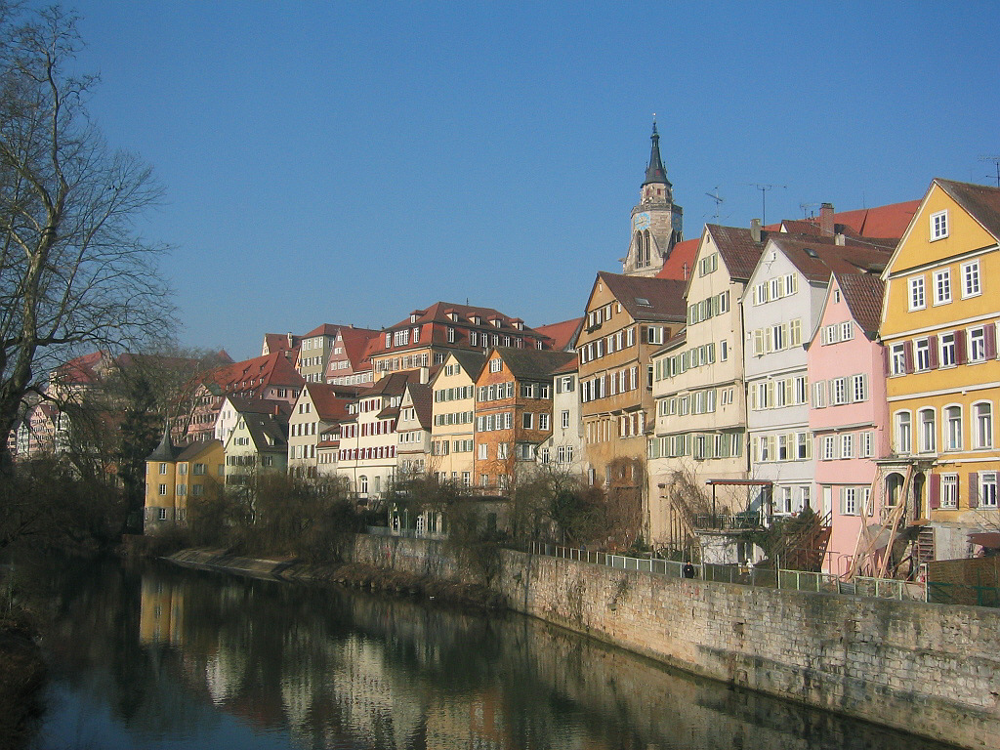

In [4]:
cImage = Image.open(contentImage_path); cImage

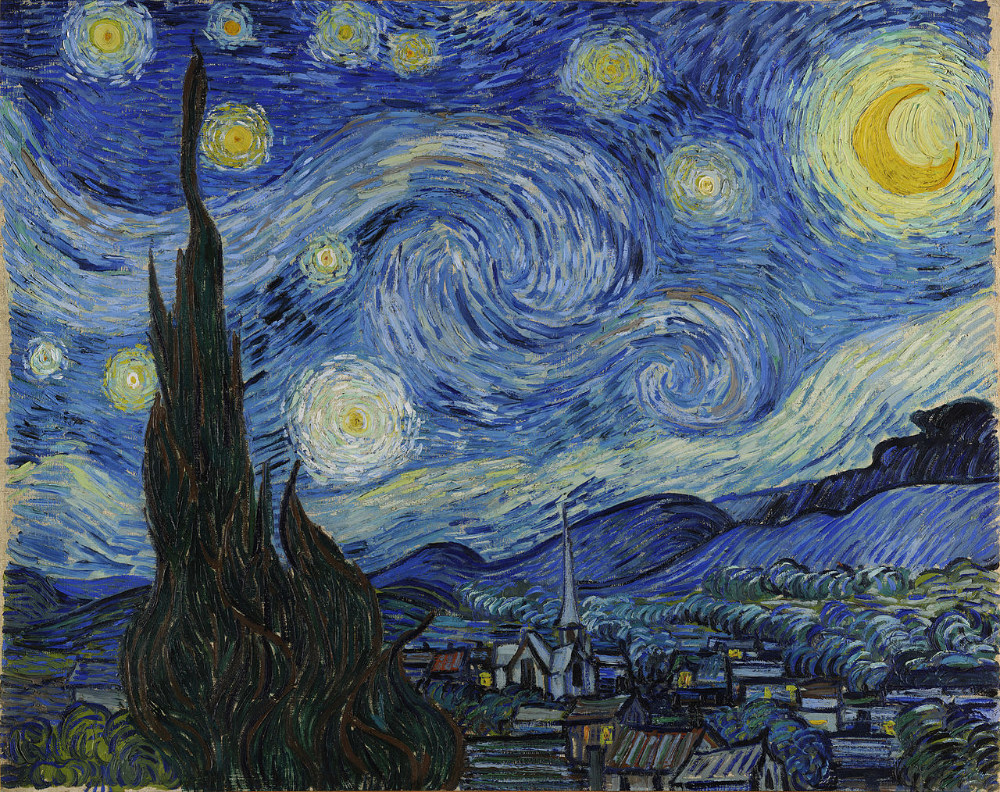

In [5]:
sImage = Image.open(styleImage_path); sImage

We need to subtract the mean of each channel of the imagenet data and 
reverse the order of RGB->BGR since those are the preprocessing steps 
that the VGG authors did - so their model won't work unless we do the same thing.

In [6]:
rn_mean = np.array([123.68, 116.779, 103.939], dtype=np.float32)
preproc = lambda x: (x - rn_mean)[:, :, :, ::-1]

In [7]:
deproc = lambda x,s: np.clip(x.reshape(s)[:, :, :, ::-1] + rn_mean, 0, 255)

In [8]:
cImg_arr = preproc(np.expand_dims(np.array(cImage), 0))
cshp = cImg_arr.shape

In [9]:
sImg_arr = preproc(np.expand_dims(np.array(sImage),0))
sshp = sImg_arr.shape

In [78]:
sImg_arr[:,:,:,:3].shape

(1, 1014, 1280, 3)

In [14]:
sshp

(1, 1014, 1280, 3)

In [10]:
print (cshp); print (sshp)

(1, 768, 1024, 3)
(1, 1014, 1280, 3)


## Recreating Image from middle CNN layers

In [11]:
model = VGG16_Avg(include_top=False)

/mnt/home/ubuntu/part2/lesson8/vgg16_avg.py:48: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (3, 3), activation="relu", name="block1_conv1", padding="same")`
  x = Convolution2D(64, 3, 3, activation='relu', border_mode='same', name='block1_conv1')(img_input)
/mnt/home/ubuntu/part2/lesson8/vgg16_avg.py:49: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (3, 3), activation="relu", name="block1_conv2", padding="same")`
  x = Convolution2D(64, 3, 3, activation='relu', border_mode='same', name='block1_conv2')(x)
/mnt/home/ubuntu/part2/lesson8/vgg16_avg.py:53: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(128, (3, 3), activation="relu", name="block2_conv1", padding="same")`
  x = Convolution2D(128, 3, 3, activation='relu', border_mode='same', name='block2_conv1')(x)
/mnt/home/ubuntu/part2/lesson8/vgg16_avg.py:54: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(128, (3, 3), activation="relu", name="block2

58867712/58889256 [============================>.] - ETA: 0s

In [20]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, None, None, 3)     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (AveragePooling2 (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (AveragePooling2 (None, None, None, 128)   0         
__________

### Content Reconstruction

In [12]:
firstLayer = model.get_layer("block1_conv2").output

In [13]:
firstLayerModel = Model(model.input, firstLayer)

In [14]:
firstLayerModel.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, None, None, 3)     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
Total params: 38,720
Trainable params: 38,720
Non-trainable params: 0
_________________________________________________________________


In [15]:
firstLayer_targ = K.variable(firstLayerModel.predict(cImg_arr))

Since we use scipy bfgs for gradient descent, we need to send ti loss function and gradients seperately.

In [14]:
class Evaluator(object):
    def __init__(self, f, shp): self.f, self.shp = f, shp
        
    def loss(self, x):
        loss_, self.grad_values = self.f([x.reshape(self.shp)])
        return loss_.astype(np.float64)

    def grads(self, x): return self.grad_values.flatten().astype(np.float64)

In [26]:
loss = K.mean(metrics.mse(firstLayer, firstLayer_targ))
grads = K.gradients(loss, model.input)
fn = K.function([model.input], [loss]+grads)
evaluator = Evaluator(fn, cshp)

In [30]:
def solve_image(eval_obj, niter, x, layerName):
    for i in range(niter):
        x, min_val, info = fmin_l_bfgs_b(eval_obj.loss, x.flatten(),
                                         fprime=eval_obj.grads, maxfun=20)
        x = np.clip(x, -127,127)
        print('Current loss value:', min_val)
        imsave(f'./results/{layerName}_res_at_iteration_{i}_content.png', deproc(x.copy(), cshp)[0])
    return x

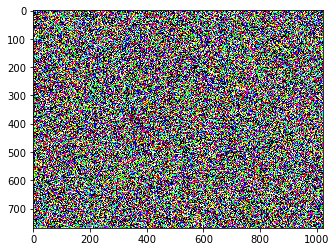

In [27]:
rand_img = lambda shape: np.random.uniform(-2.5, 2.5, shape)/100
x = rand_img(cshp)
plt.imshow(x[0]);

In [28]:
iterations = 20

In [31]:
x = solve_image(evaluator, iterations, x, "firstLayer")

Current loss value: 66.8133239746
Current loss value: 1.3841561079
Current loss value: 0.550598680973
Current loss value: 0.336077749729
Current loss value: 0.241762429476
Current loss value: 0.209795415401
Current loss value: 0.188091158867
Current loss value: 0.176538348198
Current loss value: 0.158681154251
Current loss value: 0.168392404914
Current loss value: 0.151964142919
Current loss value: 0.137678831816
Current loss value: 0.133652284741
Current loss value: 0.128487810493
Current loss value: 0.117524780333
Current loss value: 0.110350295901
Current loss value: 0.104664422572
Current loss value: 0.0995693802834
Current loss value: 0.0981965586543
Current loss value: 0.0977608636022


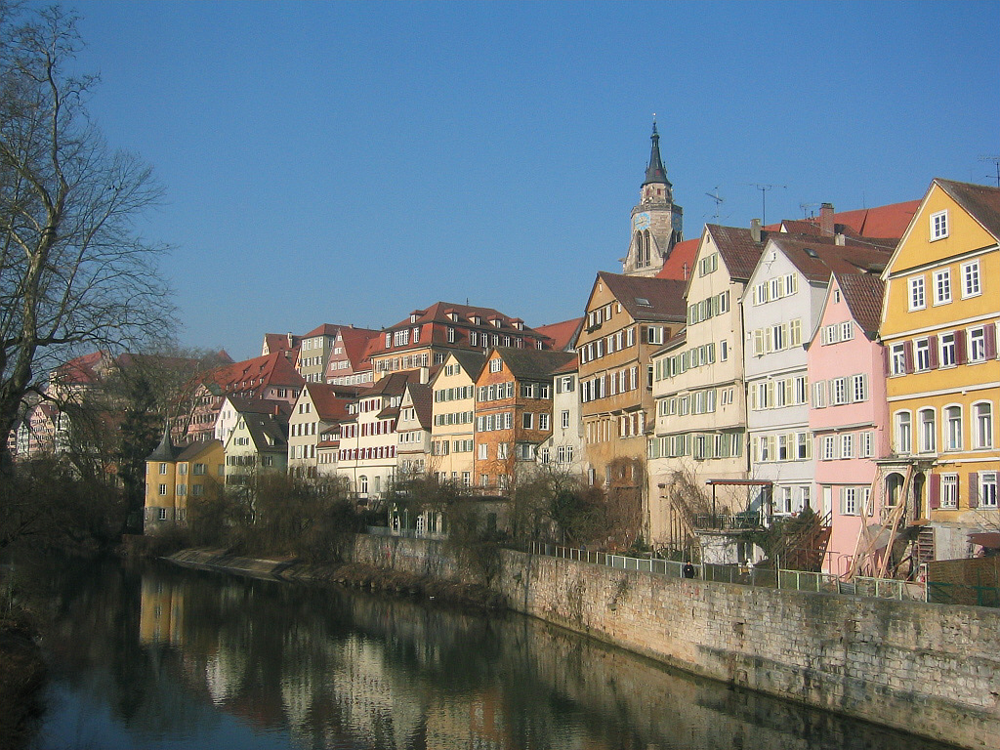

In [32]:
Image.open('./results/res_at_iteration_19_firstLayer_content.png')

In [33]:
firstLayer = model.get_layer("block1_conv2").output
secondLayer = model.get_layer("block2_conv2").output
thirdLayer = model.get_layer("block3_conv3").output
fourthLayer = model.get_layer("block4_conv3").output
fifthLayer = model.get_layer("block5_conv3").output

firstLayerModel = Model(model.input, firstLayer)
secondLayerModel = Model(model.input, secondLayer)
thirdLayerModel = Model(model.input, thirdLayer)
fourthLayerModel = Model(model.input, fourthLayer)
fifthLayerModel = Model(model.input, fifthLayer)

In [35]:
def reconstructedImage(model,layerName, img_arr, iterations):
    layer = model.get_layer(layerName).output
    layerModel = Model(model.input, layer)
    layer_targ = K.variable(layerModel.predict(img_arr))
    loss = K.mean(metrics.mse(layer, layer_targ))
    grads = K.gradients(loss, model.input)
    fn = K.function([model.input], [loss]+grads)
    evaluator = Evaluator(fn, cshp)
    x = rand_img(cshp)
    y = solve_image(evaluator, iterations, x, layerName)
    return x
    

In [48]:
x1 = reconstructedImage(model, "block1_conv2", cImg_arr, 10 )

Current loss value: 67.3386154175
Current loss value: 1.3717392683
Current loss value: 0.551096439362
Current loss value: 0.319856673479
Current loss value: 0.228867083788
Current loss value: 0.197186276317
Current loss value: 0.176670148969
Current loss value: 0.161540746689
Current loss value: 0.14920309186
Current loss value: 0.138746842742


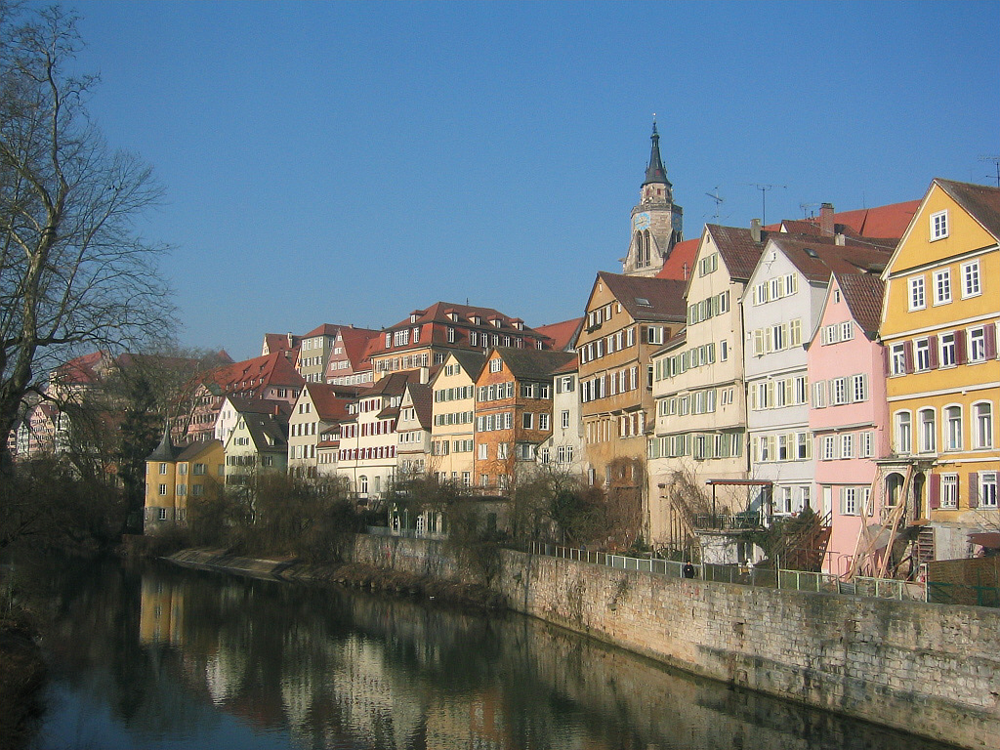

In [49]:
Image.open('./results/block1_conv2_res_at_iteration_9_content.png')

In [36]:
x2 = reconstructedImage(model, "block2_conv2", cImg_arr, 20 )
x3 = reconstructedImage(model, "block3_conv3", cImg_arr, 20 )
x4 = reconstructedImage(model, "block4_conv3", cImg_arr, 20 )
x5 = reconstructedImage(model, "block5_conv3", cImg_arr, 20 )

Current loss value: 9591.98828125
Current loss value: 3178.42749023
Current loss value: 1401.27612305
Current loss value: 799.842407227
Current loss value: 483.681732178
Current loss value: 289.644042969
Current loss value: 183.513458252
Current loss value: 124.38053894
Current loss value: 90.7190704346
Current loss value: 69.0038986206
Current loss value: 53.7325782776
Current loss value: 43.222946167
Current loss value: 36.582775116
Current loss value: 32.3211936951
Current loss value: 29.1385593414
Current loss value: 25.8697776794
Current loss value: 23.8879184723
Current loss value: 22.4581851959
Current loss value: 21.3549728394
Current loss value: 19.9115638733
Current loss value: 7017.11425781
Current loss value: 3752.59545898
Current loss value: 2869.06347656
Current loss value: 2444.66113281
Current loss value: 2166.67431641
Current loss value: 1956.65356445
Current loss value: 1801.3190918
Current loss value: 1659.94775391
Current loss value: 1543.29760742
Current loss value

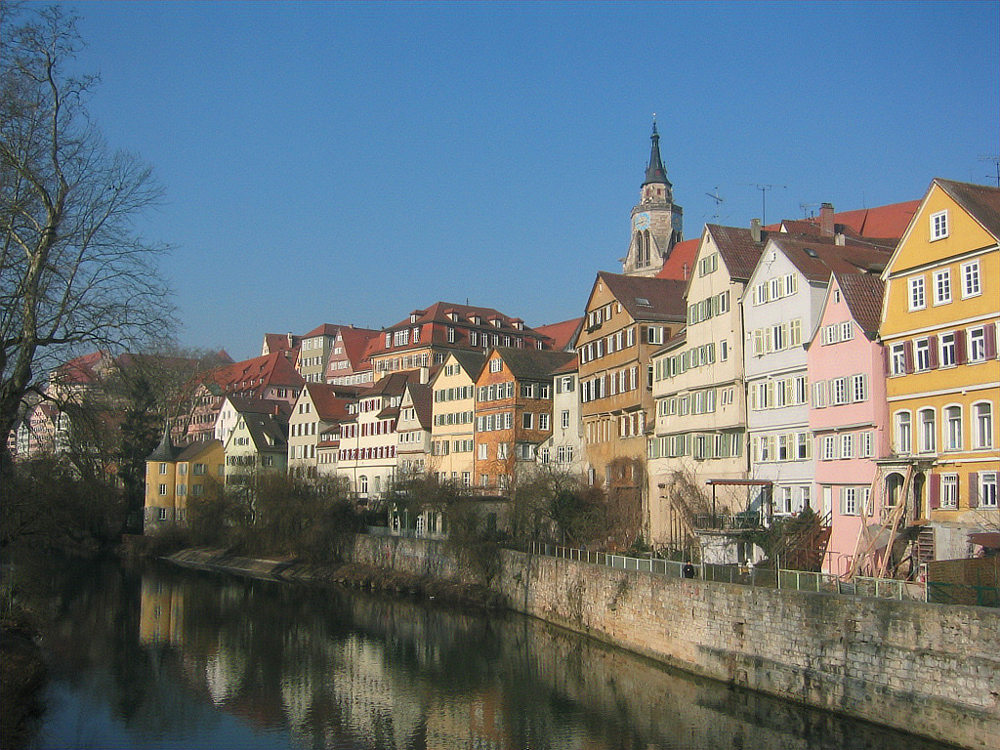

In [37]:
Image.open('./results/block2_conv2_res_at_iteration_19_content.png')

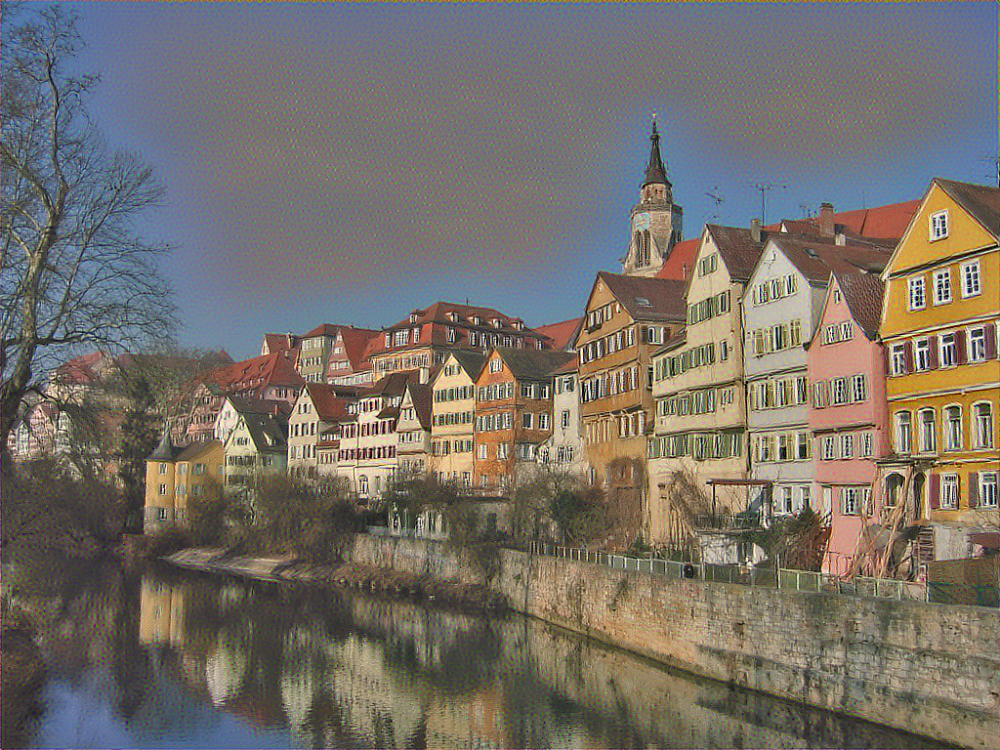

In [38]:
Image.open('./results/block3_conv3_res_at_iteration_19_content.png')

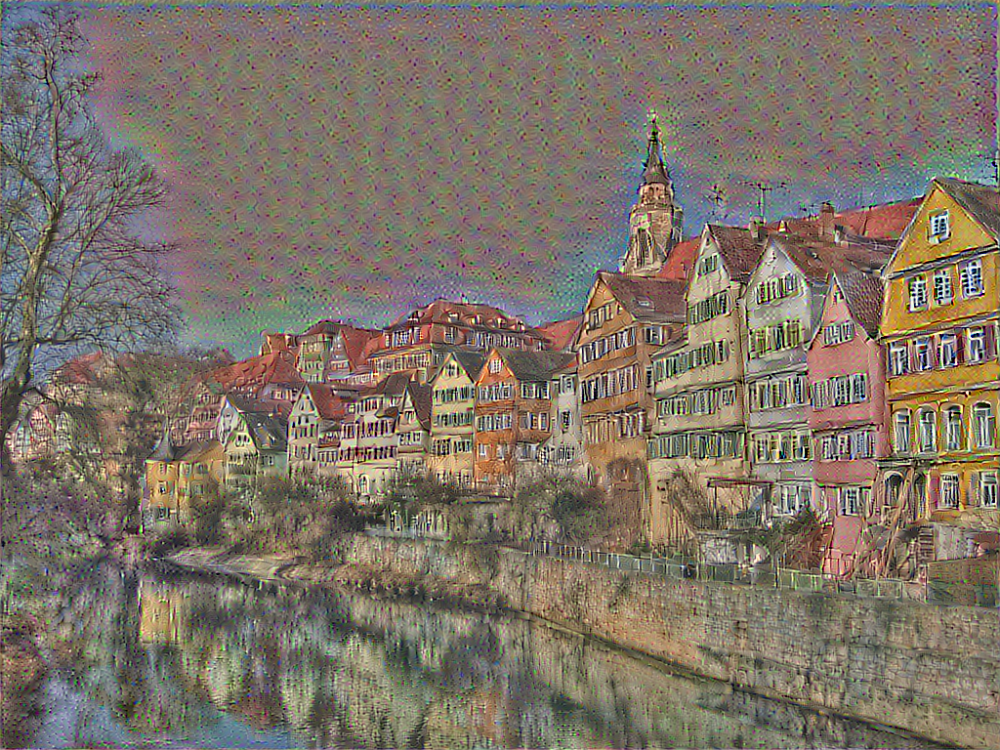

In [39]:
Image.open('./results/block4_conv3_res_at_iteration_19_content.png')

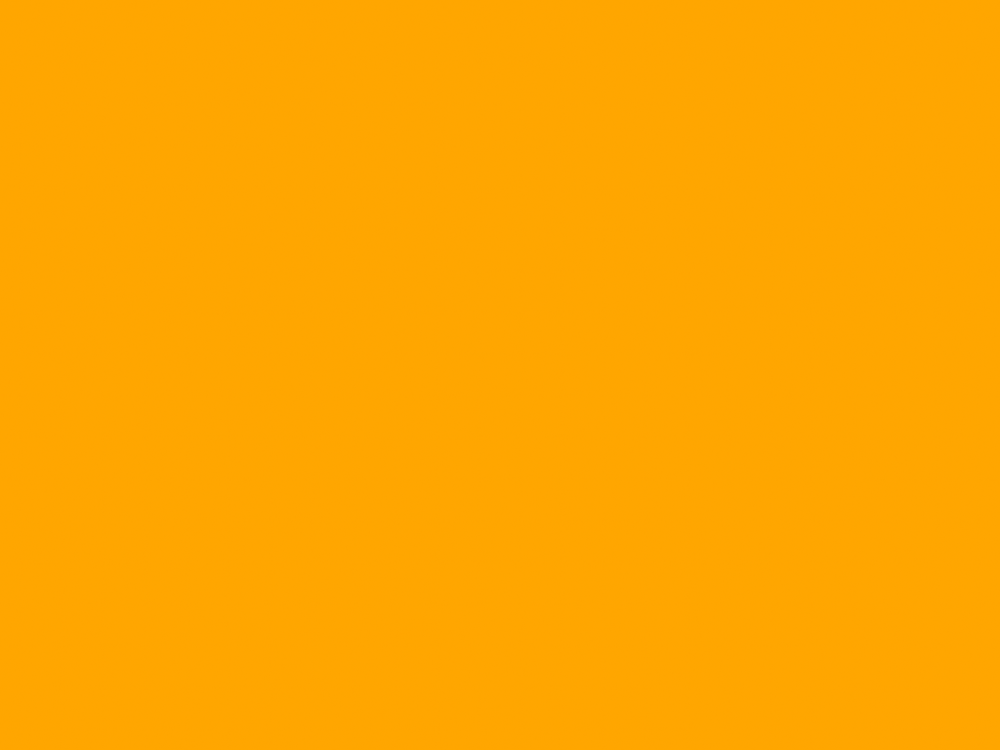

In [40]:
Image.open('./results/block5_conv3_res_at_iteration_19_content.png')

What is happening wiht the final conv block. Lets try it again

In [55]:
x5 = reconstructedImage(model, "block5_conv3", cImg_arr, 10 )

Current loss value: 0.476983487606
Current loss value: 0.476983517408
Current loss value: 0.476983487606
Current loss value: 0.476983487606
Current loss value: 0.476983487606
Current loss value: 0.476983487606
Current loss value: 0.476983487606
Current loss value: 0.476983487606
Current loss value: 0.476983487606
Current loss value: 0.476983487606


In [68]:
rand_img = lambda shape: np.random.poisson(size= shape)/100

In [58]:
def reconstructedImage(model,layerName, img_arr, iterations):
    layer = model.get_layer(layerName).output
    layerModel = Model(model.input, layer)
    layer_targ = K.variable(layerModel.predict(img_arr))
    loss = K.mean(metrics.mse(layer, layer_targ))
    grads = K.gradients(loss, model.input)
    fn = K.function([model.input], [loss]+grads)
    evaluator = Evaluator(fn, shp)
    x = rand_img(shp)
    y = solve_image(evaluator, iterations, x, layerName)
    return y

In [41]:
x5 = reconstructedImage(model, "block5_conv2", cImg_arr, 20 )

Current loss value: 9.7193479538
Current loss value: 3.56921839714
Current loss value: 3.53181624413
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037
Current loss value: 3.53212738037


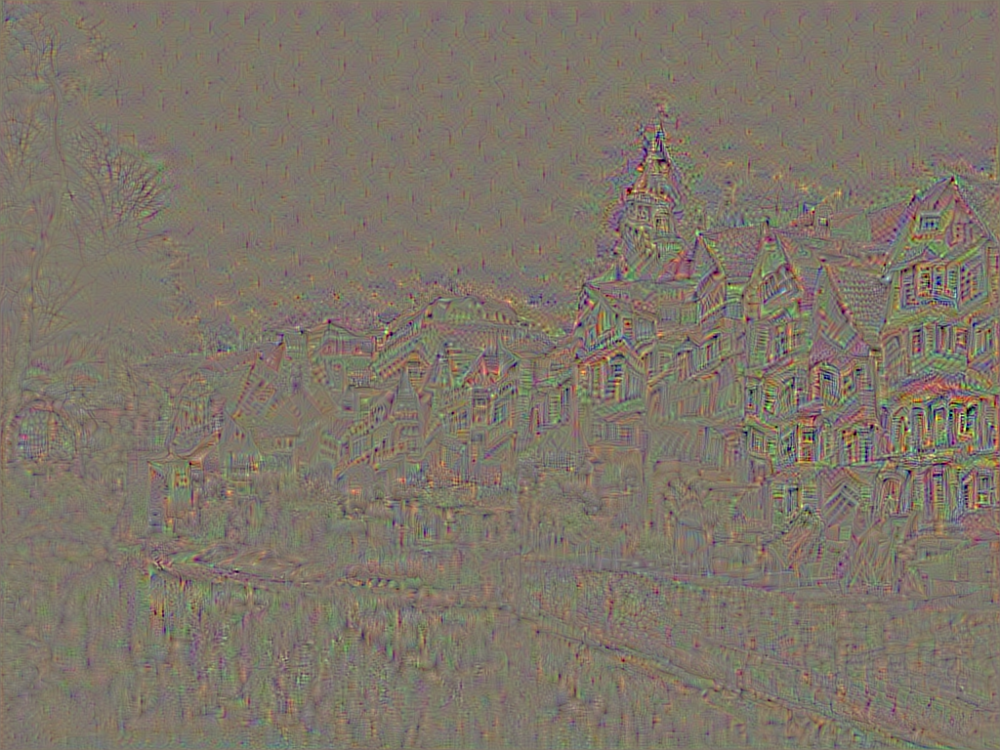

In [42]:
Image.open('./results/block5_conv2_res_at_iteration_19_content.png')

In [63]:
x5 = reconstructedImage(model, "block5_conv1", cImg_arr, 10 )

Current loss value: 32.5993156433
Current loss value: 11.0925788879
Current loss value: 6.43540525436
Current loss value: 5.02744960785
Current loss value: 4.95909786224
Current loss value: 4.96078205109
Current loss value: 4.96078157425
Current loss value: 4.96078205109
Current loss value: 4.96078205109
Current loss value: 4.96078157425


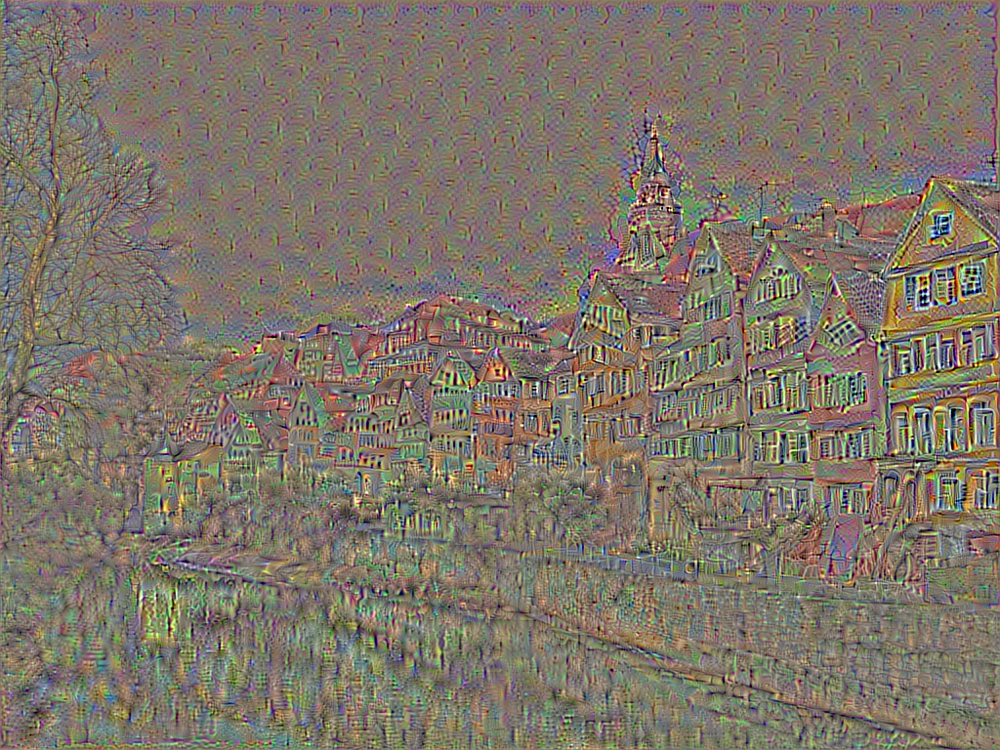

In [64]:
Image.open('./results/block5_conv1_res_at_iteration_9_content.png')

### Style Reconstruction

In [15]:
model = VGG16_Avg(include_top=False, input_shape=sshp[1:])

/mnt/home/ubuntu/part2/lesson8/vgg16_avg.py:48: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (3, 3), activation="relu", name="block1_conv1", padding="same")`
  x = Convolution2D(64, 3, 3, activation='relu', border_mode='same', name='block1_conv1')(img_input)
/mnt/home/ubuntu/part2/lesson8/vgg16_avg.py:49: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (3, 3), activation="relu", name="block1_conv2", padding="same")`
  x = Convolution2D(64, 3, 3, activation='relu', border_mode='same', name='block1_conv2')(x)
/mnt/home/ubuntu/part2/lesson8/vgg16_avg.py:53: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(128, (3, 3), activation="relu", name="block2_conv1", padding="same")`
  x = Convolution2D(128, 3, 3, activation='relu', border_mode='same', name='block2_conv1')(x)
/mnt/home/ubuntu/part2/lesson8/vgg16_avg.py:54: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(128, (3, 3), activation="relu", name="block2

In [16]:
outputs = {l.name: l.output for l in model.layers}

In [87]:
layers = [outputs['block{}_conv1'.format(o)] for o in range(1,3)]

In [88]:
layers_model = Model(model.input, layers)
targs = [K.variable(o) for o in layers_model.predict(sImg_arr)]

The key difference is our choice of loss function. Whereas before we were calculating mse of the raw convolutional outputs, here we transform them into the "gramian matrix" of their channels (that is, the product of a matrix and its transpose) before taking their mse. It's unclear why this helps us achieve our goal, but it works. One thought is that the gramian shows how our features at that convolutional layer correlate, and completely removes all location information. So matching the gram matrix of channels can only match some type of texture information, not location information.

In [17]:
def gram_matrix(x):
    # We want each row to be a channel, and the columns to be flattened x,y locations
    features = K.batch_flatten(K.permute_dimensions(x, (2, 0, 1)))
    # The dot product of this with its transpose shows the correlation 
    # between each pair of channels
    return K.dot(features, K.transpose(features)) / x.get_shape().num_elements()

In [18]:
def style_loss(x, targ): return K.mean(metrics.mse(gram_matrix(x), gram_matrix(targ)))

In [94]:
loss = sum(style_loss(l1[0], l2[0]) for l1,l2 in zip(layers, targs))
grads = K.gradients(loss, model.input)
style_fn = K.function([model.input], [loss]+grads)
evaluator = Evaluator(style_fn, sshp)

In [96]:
rand_img = lambda shape: np.random.uniform(-2.5, 2.5, shape)/1
x = rand_img(sshp)
x = sp.ndimage.filters.gaussian_filter(x, [0,2,2,0])

In [21]:
def solve_image(eval_obj, niter, x, layerName):
    for i in range(niter):
        x, min_val, info = fmin_l_bfgs_b(eval_obj.loss, x.flatten(),
                                         fprime=eval_obj.grads, maxfun=20)
        x = np.clip(x, -127,127)
        print('Current loss value:', min_val)
        imsave(f'./results/{layerName}_res_at_iteration_{i}_style.png', deproc(x.copy(), sshp)[0])
    return x

In [98]:
iterations = 20

In [100]:
x = solve_image(evaluator, iterations, x, "firstTwoLayers")

Current loss value: 6050.18701172
Current loss value: 356.376831055
Current loss value: 129.529464722
Current loss value: 88.5537948608
Current loss value: 59.5768966675
Current loss value: 36.9791946411
Current loss value: 22.6676330566
Current loss value: 14.6582889557
Current loss value: 13.3577384949
Current loss value: 13.3297958374
Current loss value: 13.3305187225
Current loss value: 13.3305187225
Current loss value: 13.3305187225
Current loss value: 13.3305187225
Current loss value: 13.3305187225
Current loss value: 13.3305187225
Current loss value: 13.3305187225
Current loss value: 13.3305187225
Current loss value: 13.3305187225
Current loss value: 13.3305187225


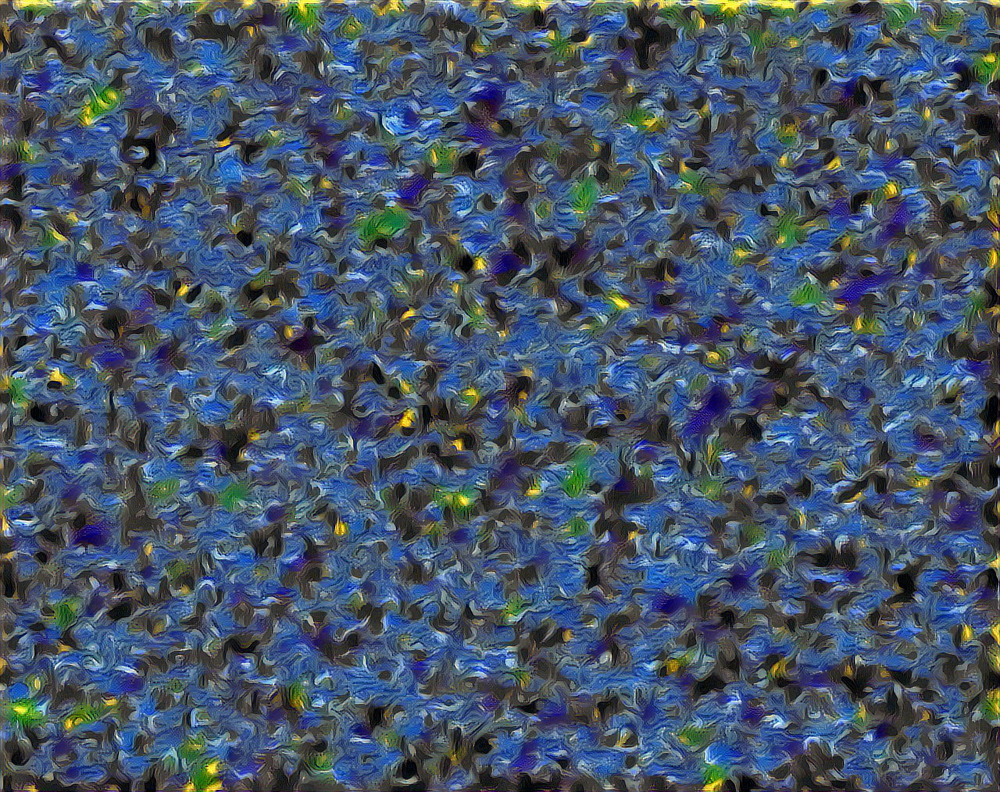

In [101]:
Image.open('./results/firstTwoLayers_res_at_iteration_19_style.png')

In [19]:
def reconstructedStyleImage(model,lastLayer, img_arr, iterations):
    layers = [outputs['block{}_conv1'.format(o)] for o in range(1,lastLayer+1)]
    layers_model = Model(model.input, layers)
    targs = [K.variable(o) for o in layers_model.predict(img_arr)]
    loss = sum(style_loss(l1[0], l2[0]) for l1,l2 in zip(layers, targs))
    grads = K.gradients(loss, model.input)
    style_fn = K.function([model.input], [loss]+grads)
    evaluator = Evaluator(style_fn, sshp)
    rand_img = lambda shape: np.random.uniform(-2.5, 2.5, shape)/1
    x = rand_img(sshp)
    x = sp.ndimage.filters.gaussian_filter(x, [0,2,2,0])
    x = solve_image(evaluator, iterations, x, "layers{}".format(lastLayer))
    return x    

In [106]:
reconstructedStyleImage(model, 2, sImg_arr, 20)

Current loss value: 6064.23046875
Current loss value: 361.293029785
Current loss value: 132.133590698
Current loss value: 89.3671875
Current loss value: 63.4255371094
Current loss value: 41.7670936584
Current loss value: 25.6185131073
Current loss value: 16.3830413818
Current loss value: 14.7502231598
Current loss value: 14.7136287689
Current loss value: 14.7144947052
Current loss value: 14.7144947052
Current loss value: 14.7144947052
Current loss value: 14.7144947052
Current loss value: 14.7144947052
Current loss value: 14.7144947052
Current loss value: 14.7144947052
Current loss value: 14.7144947052
Current loss value: 14.7144947052
Current loss value: 14.7144947052


array([   2.99403077,   59.66140699,   68.68039058,    6.39609074,
         82.80628958,  106.82993775,  -46.73320675,   31.43290143,
         71.79683103,  -11.08344728,   90.50451739,  127.        ,
         -7.85579868,  121.52530311,  127.        ,  -41.14684526,
         95.77031437,  127.        ,  -68.41938345,   62.25708768, ...,
         -9.5493244 ,   26.64828288,  -50.14276961,   -1.88702907,
         37.32041932,   -0.78332327,   40.69338155,   76.32245173,
        -27.6154669 ,   10.99369435,   29.94427743,   -7.48483645,
          8.05947491,   17.20441655,  -23.73380271,  -58.06119927,
        -40.02817334,  -56.43011064, -105.80718986,  -85.62488414])

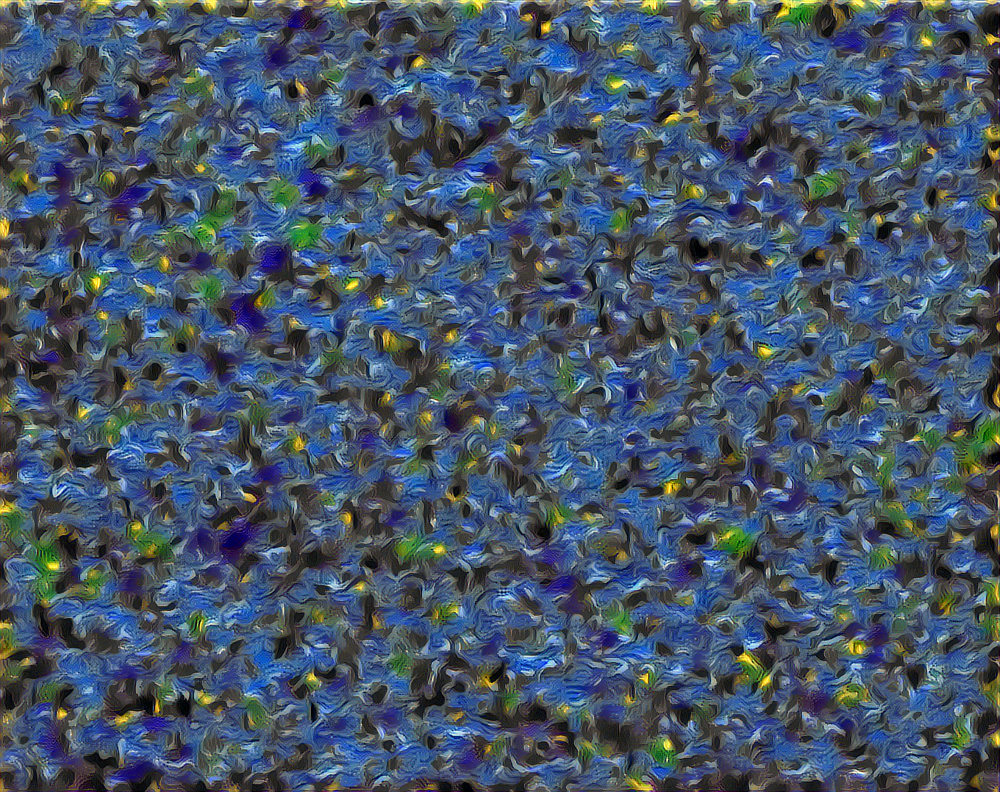

In [107]:
Image.open('./results/layers2_res_at_iteration_19_style.png')

In [22]:
reconstructedStyleImage(model, 3, sImg_arr, 20)
reconstructedStyleImage(model, 4, sImg_arr, 20)
reconstructedStyleImage(model, 5, sImg_arr, 20)

Current loss value: 5149.89013672
Current loss value: 537.078979492
Current loss value: 212.968414307
Current loss value: 142.838241577
Current loss value: 104.026626587
Current loss value: 81.2253417969
Current loss value: 63.1179428101
Current loss value: 47.255279541
Current loss value: 34.7418937683
Current loss value: 26.1042289734
Current loss value: 19.2000846863
Current loss value: 14.9183521271
Current loss value: 12.0913715363
Current loss value: 11.9258441925
Current loss value: 11.9262065887
Current loss value: 11.9262084961
Current loss value: 11.9262084961
Current loss value: 11.9262065887
Current loss value: 11.9262084961
Current loss value: 11.9262065887
Current loss value: 5312.58740234
Current loss value: 577.559570312
Current loss value: 236.135757446
Current loss value: 143.373931885
Current loss value: 108.956809998
Current loss value: 84.8984146118
Current loss value: 66.0755004883
Current loss value: 47.8687744141
Current loss value: 35.5339279175
Current loss va

array([ -32.46320611,    1.50741142,   12.19359438,   -9.77380925,
         40.77722783,   58.85169077,  -34.29891442,   19.28524799,
         38.62507135,  -51.28695521,   -0.42965135,   18.8760978 ,
       -127.        , -127.        , -100.86986176, -127.        ,
       -116.94689128, -119.77857422, -119.11205473,  -68.01401996, ...,
       -100.05026471,  -79.31914053,  -90.1449382 , -106.46450324,
        -90.63924334,  -89.33849283, -105.57102679,  -96.90748   ,
        -80.0953539 , -103.14013702,  -93.73457403,  -83.7995894 ,
       -102.35265758,  -88.6201999 ,  -84.57445651, -117.15894232,
        -88.97822959,  -81.24542733, -108.23727714,  -83.6829681 ])

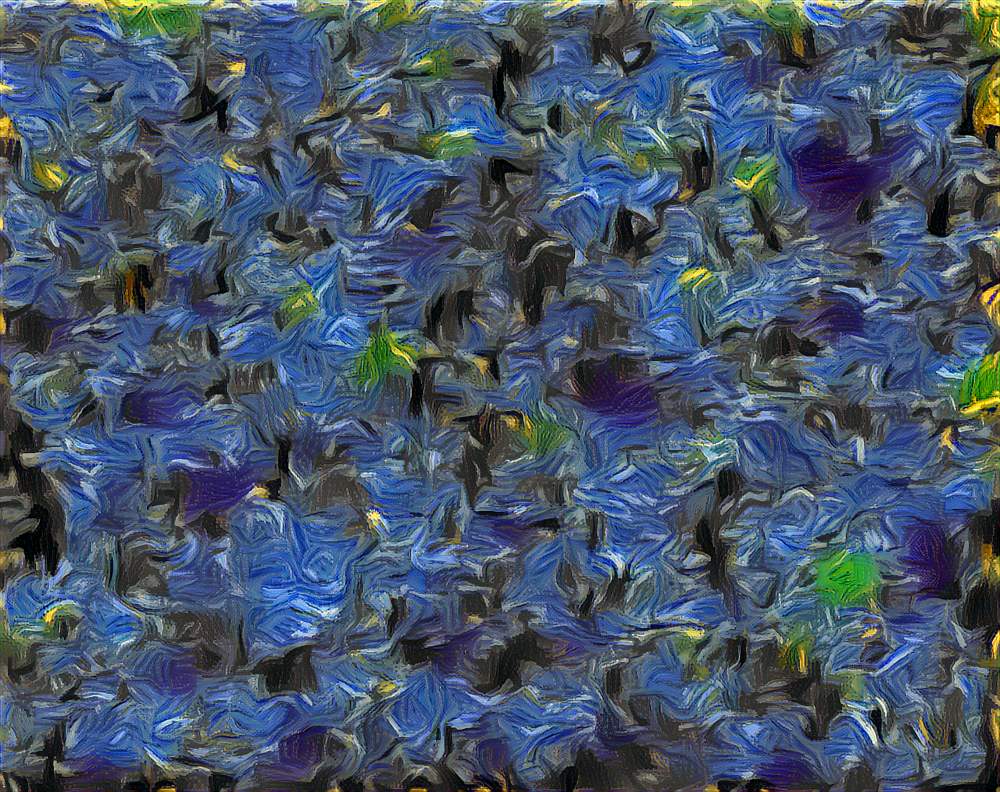

In [23]:
Image.open('./results/layers3_res_at_iteration_19_style.png')

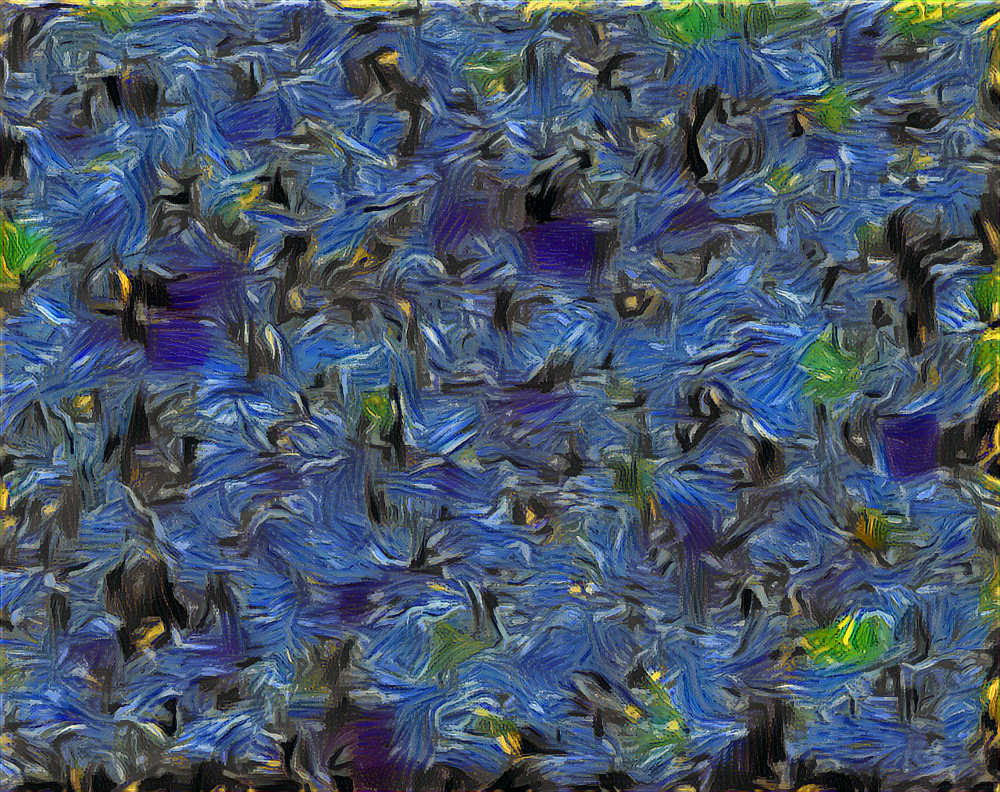

In [24]:
Image.open('./results/layers4_res_at_iteration_19_style.png')

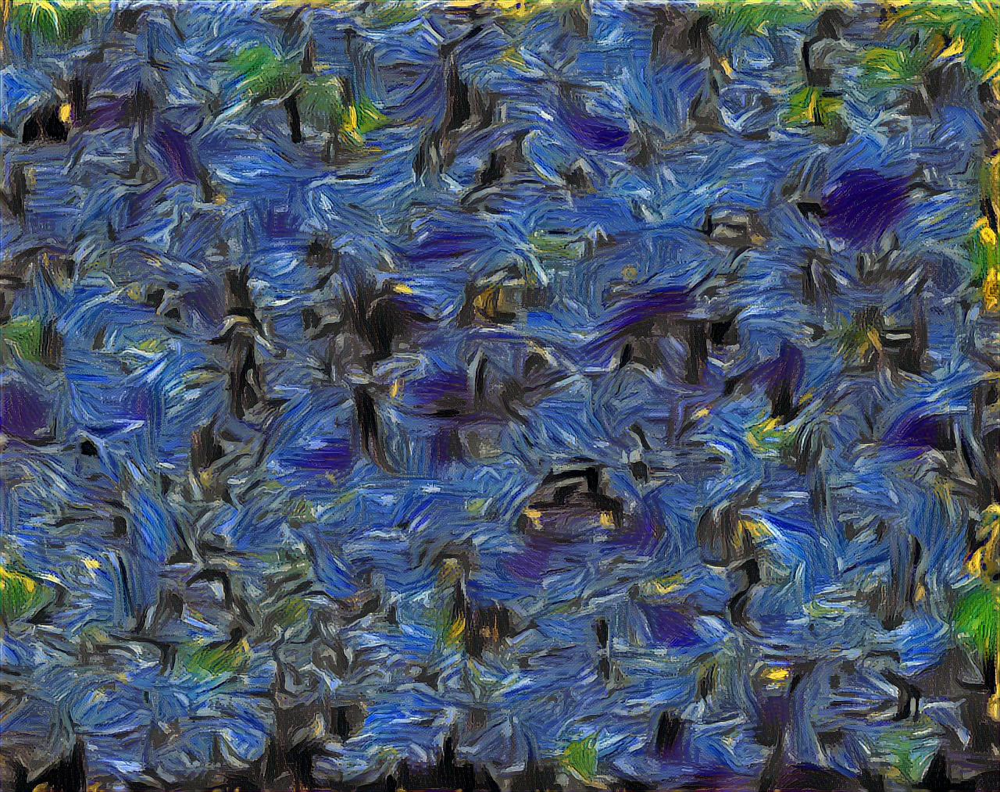

In [26]:
Image.open('./results/layers5_res_at_iteration_19_style.png')

## Style Transfer

In [56]:
class Evaluator(object):
    def __init__(self, f, shp): self.f, self.shp = f, shp
        
    def loss(self, x):
        loss_, self.grad_values = self.f([x.reshape(self.shp)])
        return loss_.astype(np.float64)

    def grads(self, x): return self.grad_values.flatten().astype(np.float64)
    
def solve_image(eval_obj, niter, x, cLayerName, sLayersCount, ratio):
    for i in range(niter):
        x, min_val, info = fmin_l_bfgs_b(eval_obj.loss, x.flatten(),
                                         fprime=eval_obj.grads, maxfun=20)
        x = np.clip(x, -127,127)
        print('Current loss value:', min_val)
        imsave(f'./results/{cLayerName}_{sLayersCount}thlayer_{ratio}_res_at_iteration_{i}_style.png', deproc(x.copy(), shp)[0])
    return x

rand_img = lambda shape: np.random.uniform(-2.5, 2.5, shape)/100

def gram_matrix(x):
    # We want each row to be a channel, and the columns to be flattened x,y locations
    features = K.batch_flatten(K.permute_dimensions(x, (2, 0, 1)))
    # The dot product of this with its transpose shows the correlation 
    # between each pair of channels
    return K.dot(features, K.transpose(features)) / x.get_shape().num_elements()

def style_loss(x, targ): return K.mean(metrics.mse(gram_matrix(x), gram_matrix(targ)))

def plot_arr(arr): plt.imshow(deproc(arr,arr.shape)[0].astype('uint8'))

In [21]:
cArr = cImg_arr
sArr = sImg_arr[:,:h,:w,:]

In [24]:
shp = sArr.shape

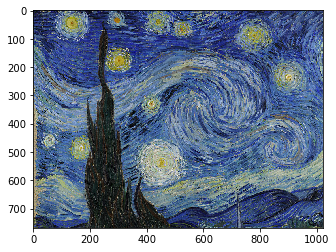

In [23]:
plot_arr(sArr)

In [25]:
model = VGG16_Avg(include_top=False, input_shape=shp[1:])

/mnt/60/home/ubuntu/part2/lesson8/vgg16_avg.py:48: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (3, 3), activation="relu", name="block1_conv1", padding="same")`
  x = Convolution2D(64, 3, 3, activation='relu', border_mode='same', name='block1_conv1')(img_input)
/mnt/60/home/ubuntu/part2/lesson8/vgg16_avg.py:49: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (3, 3), activation="relu", name="block1_conv2", padding="same")`
  x = Convolution2D(64, 3, 3, activation='relu', border_mode='same', name='block1_conv2')(x)
/mnt/60/home/ubuntu/part2/lesson8/vgg16_avg.py:53: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(128, (3, 3), activation="relu", name="block2_conv1", padding="same")`
  x = Convolution2D(128, 3, 3, activation='relu', border_mode='same', name='block2_conv1')(x)
/mnt/60/home/ubuntu/part2/lesson8/vgg16_avg.py:54: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(128, (3, 3), activation="relu", 

58597376/58889256 [============================>.] - ETA: 0s

In [27]:
outputs = {l.name: l.output for l in model.layers}
style_layers = [outputs['block{}_conv1'.format(o)] for o in range(1,6)]

In [28]:
content_name = 'block4_conv2'
content_layer = model.get_layer(content_name).output

In [29]:
style_model = Model(model.input, style_layers)
style_targs = [K.variable(o) for o in style_model.predict(sArr)]

In [30]:
content_model = Model(model.input, content_layer)
content_targ = K.variable(content_model.predict(cArr))

In [31]:
style_wgts = [0.05,0.2,0.2,0.25,0.3]

In [32]:
loss = sum(style_loss(l1[0], l2[0])*w
           for l1,l2,w in zip(style_layers, style_targs, style_wgts))
loss += K.mean(metrics.mse(content_layer, content_targ)/10)
grads = K.gradients(loss, model.input)
transfer_fn = K.function([model.input], [loss]+grads)

In [33]:
evaluator = Evaluator(transfer_fn, shp)

In [37]:
x = rand_img(shp)

In [38]:
x = solve_image(evaluator, 100, x)

Current loss value: 1751.73095703
Current loss value: 254.041931152
Current loss value: 160.020935059
Current loss value: 130.498718262
Current loss value: 115.403091431
Current loss value: 105.201011658
Current loss value: 98.1547927856
Current loss value: 93.0345458984
Current loss value: 89.1186599731
Current loss value: 85.9597473145
Current loss value: 83.2381210327
Current loss value: 80.8317108154
Current loss value: 78.8047790527
Current loss value: 76.9744033813
Current loss value: 75.2071990967
Current loss value: 73.9170455933
Current loss value: 72.6516799927
Current loss value: 71.5254440308
Current loss value: 70.591293335
Current loss value: 69.6727142334
Current loss value: 68.9136886597
Current loss value: 68.1474227905
Current loss value: 67.60987854
Current loss value: 67.0189971924
Current loss value: 66.4943618774
Current loss value: 65.9502258301
Current loss value: 65.5564727783
Current loss value: 65.0345230103
Current loss value: 64.5409164429
Current loss valu

KeyboardInterrupt: 

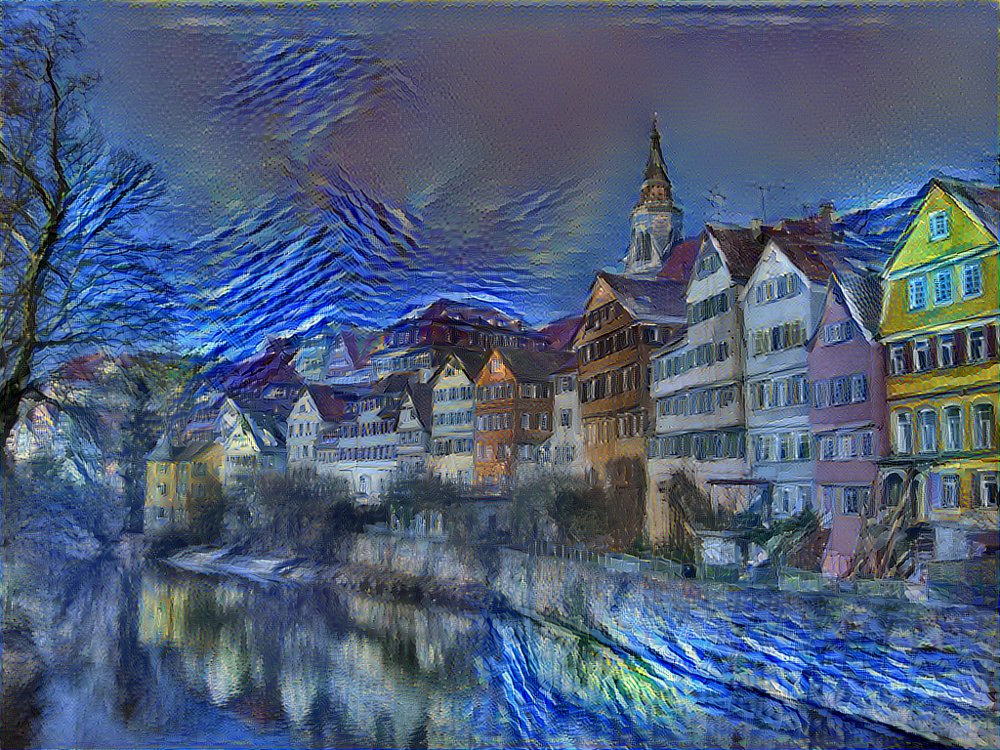

In [39]:
Image.open('./results/layer4_res_at_iteration_29_style.png')

In [57]:
def getStyleTransferredImage(model, cArr, sArr, cLayer, sLayer, ratio, x, iterations):
    outputs = {l.name: l.output for l in model.layers}
    style_layers = [outputs['block{}_conv1'.format(o)] for o in range(1,sLayer)]
    content_layer = model.get_layer(cLayer).output
    style_model = Model(model.input, style_layers)
    style_targs = [K.variable(o) for o in style_model.predict(sArr)]
    content_model = Model(model.input, content_layer)
    content_targ = K.variable(content_model.predict(cArr))
    style_wgts = [0.05,0.2,0.2,0.25,0.3]
    loss = sum(style_loss(l1[0], l2[0])*w
           for l1,l2,w in zip(style_layers, style_targs, style_wgts))
    loss += K.mean(metrics.mse(content_layer, content_targ)/ratio)
    grads = K.gradients(loss, model.input)
    transfer_fn = K.function([model.input], [loss]+grads)
    evaluator = Evaluator(transfer_fn, shp)
    x = solve_image(evaluator, iterations, x, cLayer, sLayer, ratio)
    return x

In [42]:
x = rand_img(shp)

In [43]:
x = getStyleTransferredImage(model, cArr, sArr, 'block4_conv2', 5, 100, x, 25)

Current loss value: 1728.07775879
Current loss value: 245.953903198
Current loss value: 155.206359863
Current loss value: 127.696426392
Current loss value: 113.036659241
Current loss value: 103.784698486
Current loss value: 97.4721908569
Current loss value: 92.6895980835
Current loss value: 88.9063339233
Current loss value: 85.7819824219
Current loss value: 82.9682922363
Current loss value: 80.7304229736
Current loss value: 78.9767456055
Current loss value: 77.4699249268
Current loss value: 76.3335952759
Current loss value: 75.1804962158
Current loss value: 74.2297363281
Current loss value: 73.2515792847
Current loss value: 72.400718689
Current loss value: 71.8415298462
Current loss value: 71.0951766968
Current loss value: 70.4694061279
Current loss value: 69.7802124023
Current loss value: 69.3251419067
Current loss value: 68.5829086304
Current loss value: 67.9152450562
Current loss value: 67.2985305786
Current loss value: 66.7838745117
Current loss value: 66.3835525513
Current loss va

KeyboardInterrupt: 

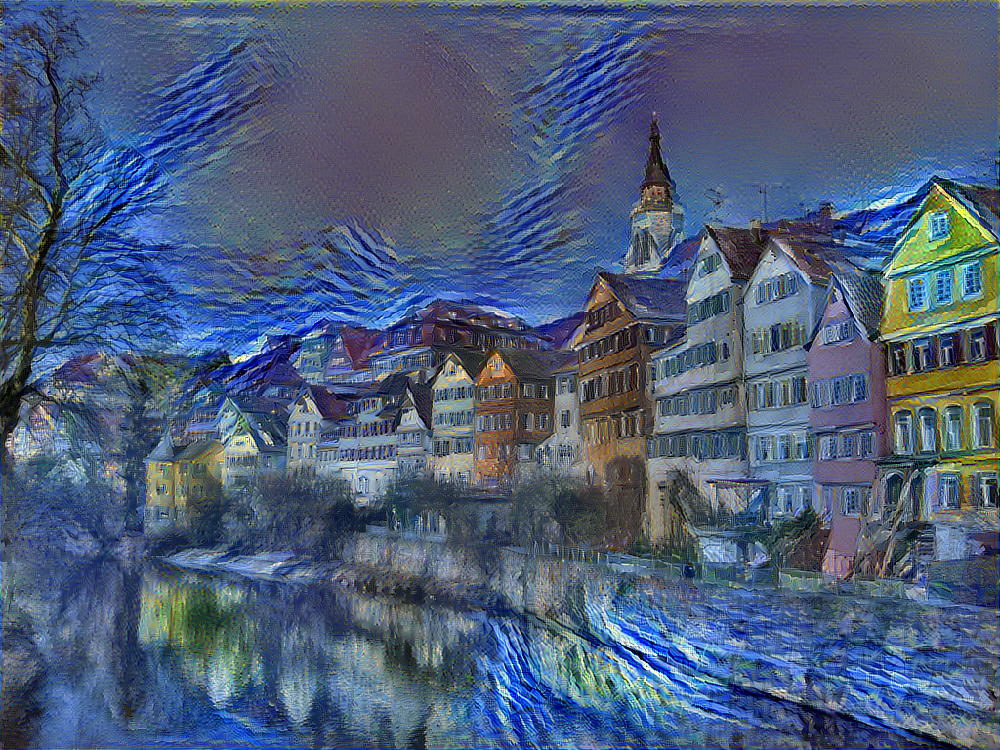

In [45]:
Image.open('./results/block4_conv2_5thlayer_res_at_iteration_24_style.png')

In [46]:
cLayers = ['block3_conv1', 'block4_conv2', 'block5_conv1']
ratios = [10, 100, 1000, 10000]

In [47]:
combs = list(itertools.product(cLayers, ratios))

In [48]:
combs

[('block3_conv1', 10),
 ('block3_conv1', 100),
 ('block3_conv1', 1000),
 ('block3_conv1', 10000),
 ('block4_conv2', 10),
 ('block4_conv2', 100),
 ('block4_conv2', 1000),
 ('block4_conv2', 10000),
 ('block5_conv1', 10),
 ('block5_conv1', 100),
 ('block5_conv1', 1000),
 ('block5_conv1', 10000)]

In [ ]:
for i in combs:
    x = rand_img(shp)
    x = getStyleTransferredImage(model, cArr, sArr, i[0] , 5, i[1], x, 25)
    

Current loss value: 3930.10375977
Current loss value: 1599.84387207
Current loss value: 1384.68664551
Current loss value: 1303.2833252
Current loss value: 1262.18457031
Current loss value: 1233.70288086
Current loss value: 1215.86376953
Current loss value: 1204.11206055
Current loss value: 1196.55639648
Current loss value: 1191.51135254
Current loss value: 1187.51501465
Current loss value: 1184.40356445
Current loss value: 1181.89013672
Current loss value: 1179.80517578
Current loss value: 1178.05859375
Current loss value: 1176.53198242
Current loss value: 1175.15222168
Current loss value: 1173.94604492
Current loss value: 1172.88830566
Current loss value: 1171.94372559
Current loss value: 1171.10778809
Current loss value: 1170.3729248
Current loss value: 1169.70019531
Current loss value: 1169.09741211
Current loss value: 1168.54626465
Current loss value: 2133.9465332
Current loss value: 394.598022461
Current loss value: 301.248809814
Current loss value: 271.638793945
Current loss valu

In [51]:
combs[0][0]

'block3_conv1'

In [ ]:
Image.open('./results/block3_conv1_5thlayer_10_res_at_iteration_24_style.png')

In [ ]:
Image.open('./results/block3_conv1_5thlayer_100_res_at_iteration_24_style.png')

In [ ]:
Image.open('./results/block3_conv1_5thlayer_1000_res_at_iteration_24_style.png')

In [ ]:
Image.open('./results/block3_conv1_5thlayer_10000_res_at_iteration_24_style.png')

In [ ]:
Image.open('./results/block4_conv2_5thlayer_10_res_at_iteration_24_style.png')

In [ ]:
Image.open('./results/block4_conv2_5thlayer_100_res_at_iteration_24_style.png')

In [ ]:
Image.open('./results/block4_conv2_5thlayer_1000_res_at_iteration_24_style.png')

In [ ]:
Image.open('./results/block4_conv2_5thlayer_10000_res_at_iteration_24_style.png')

In [ ]:
Image.open('./results/block5_conv1_5thlayer_10_res_at_iteration_24_style.png')

In [ ]:
Image.open('./results/block5_conv1_5thlayer_100_res_at_iteration_24_style.png')

In [ ]:
Image.open('./results/block5_conv1_5thlayer_1000_res_at_iteration_24_style.png')

In [ ]:
Image.open('./results/block5_conv1_5thlayer_10000_res_at_iteration_24_style.png')